# 1.Imports

In [1]:
import torch; torch.manual_seed(0)
import torch.nn as nn
import torch.nn.functional as F

from torch.utils.data import DataLoader
from torchvision.datasets import MNIST
from torchvision.transforms import ToTensor

import torch.utils
import torch.distributions
import torchvision
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
#plt.rcParams['figure.dpi'] = 200

device = 'cuda' if torch.cuda.is_available() else 'cpu'

# 2.Get data and visualize

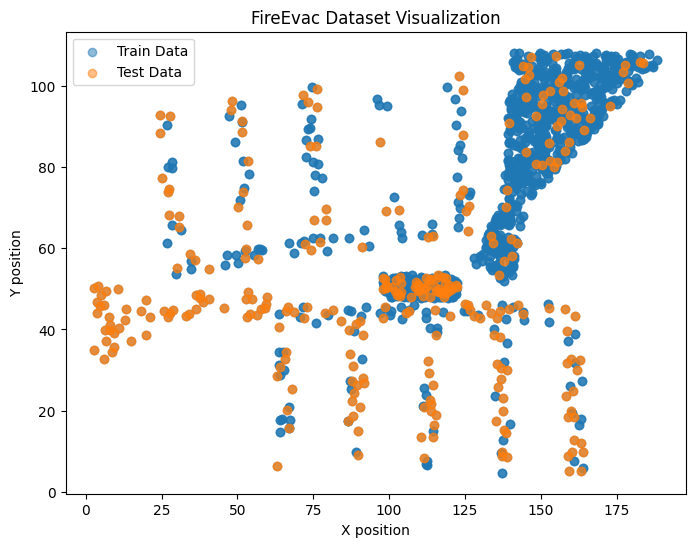

In [2]:
# Load the datasets
train_data = np.load('FireEvac_train_set.npy')
test_data = np.load('FireEvac_test_set.npy')

# Visualize the train and test datasets with scatter plots
plt.figure(figsize=(8, 6))
plt.scatter(train_data[:, 0], train_data[:, 1], label='Train Data', alpha=0.5)
plt.scatter(test_data[:, 0], test_data[:, 1], label='Test Data', alpha=0.5)
plt.title('FireEvac Dataset Visualization')
plt.xlabel('X position')
plt.ylabel('Y position')
plt.legend()
plt.show()

# 3.VAE

In [3]:
class VariationalEncoder(nn.Module):
    def __init__(self):
        super(VariationalEncoder, self).__init__()
        self.linear1 = nn.Linear(2, 64)  # Adjust input to 2 dimensions
        self.linear2 = nn.Linear(64, 64)
        self.mu = nn.Linear(64, 2)  # Output 2 dimensions for mean
        self.log_var = nn.Linear(64, 2)  # Output 2 dimensions for log variance

    def forward(self, x):
        x = F.relu(self.linear1(x))
        x = F.relu(self.linear2(x))
        mu = self.mu(x)
        log_var = self.log_var(x)
        return mu, log_var

class Decoder(nn.Module):
    def __init__(self):
        super(Decoder, self).__init__()
        self.linear1 = nn.Linear(2, 64)  # Adjust input to 2 dimensions
        self.linear2 = nn.Linear(64, 64)
        self.output = nn.Linear(64, 2)  # Output 2 dimensions for reconstructed output

    def forward(self, z):
        z = F.relu(self.linear1(z))
        z = F.relu(self.linear2(z))
        x_recon = self.output(z)
        return x_recon

class VariationalAutoencoder(nn.Module):
    def __init__(self, latent_dims):
        super(VariationalAutoencoder, self).__init__()
        self.encoder = VariationalEncoder()
        self.decoder = Decoder()
        
    def reparameterize(self, mu, sigma):
        std = torch.exp(0.5 * sigma)
        eps = torch.randn_like(std)
        z = mu + eps * std
        return z
        
    def forward(self, x):
        mu, sigma = self.encoder(x)
        z = self.reparameterize(mu, sigma)
        x_recon = self.decoder(z)
        return x_recon, mu, sigma

    def generate_samples(self, num_samples):
        z = torch.randn(num_samples,latent_dims).to(device)
        samples = self.decoder(z)
        return samples

# 4.Define functions

In [4]:
def elbo_loss(x, x_hat, mu, log_var):
    #Reconstruction
    recon_loss = F.binary_cross_entropy(torch.sigmoid(x_hat), x, reduction='sum')

    #Regularisation
    kl_div = -0.5 * torch.sum(1 + log_var - mu.pow(2) - log_var.exp())

    return recon_loss + kl_div

In [5]:
train_losses = []
def train(autoencoder, data_loader, epochs):
    opt = torch.optim.Adam(autoencoder.parameters(),lr=0.005) # Set up the optimizer
    autoencoder.train()
    for epoch in range(epochs):
        total_loss = 0
        for batch in data_loader:
            #x = x.view(-1, 784).to(device) # CPU
            opt.zero_grad()
            x = batch.to(device)
            x_hat, mu, logvar = autoencoder(x)
            loss =elbo_loss(x, x_hat, mu, logvar)
            loss.backward()
            opt.step()
            total_loss += loss.item()
        print(f'Epoch {epoch+1}/{epochs}, Train Loss: {total_loss:.4f}')
    return autoencoder



test_losses = []
def test(autoencoder, data, epochs):
    # autoencoder.eval()
    with torch.no_grad():
        for epoch in range(epochs):
            autoencoder.eval()
            epoch_loss = 0.0
            for x, y in data:
                x = x.to(device) # CPU
                x_hat,mu, logvar = autoencoder(x)
                loss =elbo_loss(x, x_hat, mu, logvar)
                epoch_loss +=  loss.item()
            epoch_loss = epoch_loss / len(data.dataset)
            test_losses.append(epoch_loss)
    return test_losses

In [6]:
#plot the latent representation
def plot_latent(autoencoder, data, num_batches=128):
    latent_vectors = []
    labels = []
    for i, (x, y) in enumerate(data): 
        x = x.view(-1, 2)
        z,j = autoencoder.encoder(x.to(device))
        z = z.to('cpu').detach().numpy()
        plt.scatter(z[:, 0], z[:, 1], c=y, cmap='tab10') 
    plt.colorbar()
    plt.title('Latent Representation')
    plt.xlabel('Latent Dimension 1')
    plt.ylabel('Latent Dimension 2')

In [7]:
#plot reconstructed digits and the corresponding original ones
def plot_reconstructed(autoencoder, data, num_digits=15):
    """
    for batch in data:
        x, y = batch
        break
    """
    #print(x.shape)
    #x = x.to(device)
    x = data
    z,i,j = autoencoder(x)
    x = x.cpu().numpy()
    z = z.cpu().detach().numpy() 
    #x = x.view(-1, 28, 28).cpu().numpy()
    #z = z.view(-1, 28, 28).cpu().detach().numpy()  
    #Original Digits
    fig, axes = plt.subplots(3, 5,figsize=(8, 4))
    for i in range(15):
        row = i // 5  # Calculate the row index
        col = i % 5   # Calculate the column index
        axes[row, col].imshow(x[i])  # Display the image
        axes[row, col].axis('off')   
    plt.suptitle('Original Digits')
    
    #Reconstructed Digits
    fig, axes = plt.subplots(3, 5,figsize=(8, 4))
    for i in range(15):
        row = i // 5  # Calculate the row index
        col = i % 5   # Calculate the column index
        axes[row, col].imshow(z[i])  # Display the image
        axes[row, col].axis('off') 
    plt.suptitle('Reconstructed Digits')
    plt.show()

In [8]:
#plot generated digits
def plot_generated(autoencoder, num_samples=15):
    z = autoencoder.generate_samples(num_samples) 
    z = z.view(-1, 28, 28).cpu().detach().numpy() 

    fig, axes = plt.subplots(3, 5,figsize=(8, 4))
    for i in range(15):
        row = i // 5  # Calculate the row index
        col = i % 5   # Calculate the column index
        axes[row, col].imshow(z[i])  # Display the image
        axes[row, col].axis('off') 
    plt.suptitle('Generated Digits')
    plt.show()

In [9]:
def plot_losses(train_losses,test_losses,epochs):
    plt.figure(figsize=(8, 6))
    print('Train Loss',train_losses)
    print('Test Loss',test_losses)
    plt.plot(range(1, epochs+1), train_losses, label='Train Loss')
    plt.plot(range(1, epochs+1), test_losses, label='Test Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Test Loss (Negative ELBO)')
    plt.title('Test Loss Curve')
    plt.legend()
    plt.show()

In [10]:
def plot_reconstructed_scatter(vae_model, test_data):
    
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    vae_model = vae_model.to(device)
    test_tensor = torch.Tensor(test_data).to(device)

    # Get reconstructed data from the VAE
    with torch.no_grad():
        vae_model.eval()
        reconstructed_data, _, _ = vae_model(test_tensor)

    # Convert reconstructed data to NumPy array and move it to the CPU
    reconstructed_data = reconstructed_data.cpu().numpy()

    # Plot the reconstructed test data points
    plt.figure(figsize=(8, 6))
    plt.scatter(reconstructed_data[:, 0], reconstructed_data[:, 1], label='Reconstructed Test Data', alpha=0.5)
    plt.title('Reconstructed Test Set Scatter Plot')
    plt.xlabel('Dimension 1')
    plt.ylabel('Dimension 2')
    plt.legend()
    plt.show()

In [11]:
def plot_generated_samples(vae_model, num_samples=1000):
    # Generate 1000 samples using the VAE model
    generated_samples = vae_model.generate_samples(num_samples)
    
    # Detach the generated samples and convert to NumPy array
    generated_samples = generated_samples.detach().cpu().numpy()
    
    # Plot a scatter plot of the generated samples
    plt.figure(figsize=(8, 6))
    plt.scatter(generated_samples[:, 0], generated_samples[:, 1], label='Generated Samples', alpha=0.5)
    plt.title('Scatter Plot of Generated Samples')
    plt.xlabel('Dimension 1')
    plt.ylabel('Dimension 2')
    plt.legend()
    plt.show()

In [12]:
def estimate_critical_number(model):
    # Generate a large number of samples
    num_samples = 1000000
    generated_samples = model.generate_samples(num_samples)

    min_x, max_x = float('inf'), float('-inf')
    min_y, max_y = float('inf'), float('-inf')

    for sample in generated_samples:
        x, y = sample
        x = x.detach().item()
        y = y.detach().item()
        min_x = min(min_x, x)
        max_x = max(max_x, x)
        min_y = min(min_y, y)
        max_y = max(max_y, y)
    # Count the number of people within the sensitive area
    num_people_sensitive_area = 0
    for sample in generated_samples:
        x, y = sample
        x = x.detach().item()
        y = y.detach().item()
        x = (x - min_x) * (200 / (max_x - min_x))
        y = (y - min_y) * (125 / (max_y - min_y))
        #print(x,y)
        # Check if the position falls within the sensitive area
        #if 0.3 <= x <= 0.5 and -0.2 <= y <= 0.12:
        if 130 <= x <= 150 and 50 <= y <= 70:
            #print(x,y)
            num_people_sensitive_area += 1

    # Check if the critical threshold is exceeded
    if num_people_sensitive_area > critical_number_threshold:
        print(f"Critical number of people exceeded! Total count: {num_people_sensitive_area}")
    else:
        print(f"Total number of people within the sensitive area: {num_people_sensitive_area}")


# 5.Dataset

In [13]:
# Load FireEvac dataset
train_data = np.load('FireEvac_train_set.npy')
test_data = np.load('FireEvac_test_set.npy')


# Define a scaler 
scaler = MinMaxScaler(feature_range=(-1, 1))

# Rescale train_data
train_data= scaler.fit_transform(train_data)

# Rescale test_data using the same scaler
test_data = scaler.transform(test_data)

print(test_data)
# Convert to PyTorch tensors
train_tensor = torch.Tensor(train_data)
test_tensor = torch.Tensor(test_data)

# Create DataLoader for training
train_loader = torch.utils.data.DataLoader(train_tensor, batch_size=128, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_tensor, batch_size=128, shuffle=False)

[[-0.17598183  0.20342972]
 [-0.73167217  0.35092712]
 [-0.45613111  0.18104738]
 ...
 [-0.46015087 -0.17097493]
 [-0.9564204  -0.13276903]
 [-0.66162914 -0.24624472]]


# 6.Training

In [14]:
# Set the variables
input_dim = 2  #
latent_dims = 2  # Dimension of the latent space
hidden_dim = 64  # Number of hidden units in the encoder and decoder
learning_rate = 0.005  # Learning rate for the optimizer
batch_size = 64  # Batch size for training
critical_number_threshold = 100


# latent_dims = 2 # Dimension of the latent space
vae = VariationalAutoencoder(latent_dims).to(device)

Epoch 1/200, Train Loss: 3985.7128
Epoch 2/200, Train Loss: 3890.8577
Epoch 3/200, Train Loss: 2686.1624
Epoch 4/200, Train Loss: -3466.8697
Epoch 5/200, Train Loss: -6050.5755
Epoch 6/200, Train Loss: -6292.8502
Epoch 7/200, Train Loss: -7834.6390
Epoch 8/200, Train Loss: -7990.8649
Epoch 9/200, Train Loss: -8841.5965
Epoch 10/200, Train Loss: -9201.0202
Epoch 11/200, Train Loss: -9181.9408
Epoch 12/200, Train Loss: -9294.1776
Epoch 13/200, Train Loss: -10417.5322
Epoch 14/200, Train Loss: -11563.6109
Epoch 15/200, Train Loss: -13337.4223
Epoch 16/200, Train Loss: -13471.9414
Epoch 17/200, Train Loss: -13889.6918
Epoch 18/200, Train Loss: -14260.1065
Epoch 19/200, Train Loss: -15421.1512
Epoch 20/200, Train Loss: -15710.9085
Epoch 21/200, Train Loss: -15760.0710
Epoch 22/200, Train Loss: -15911.6889
Epoch 23/200, Train Loss: -16582.3974
Epoch 24/200, Train Loss: -16711.4248
Epoch 25/200, Train Loss: -17102.0081
Epoch 26/200, Train Loss: -17506.6518
Epoch 27/200, Train Loss: -16926.968

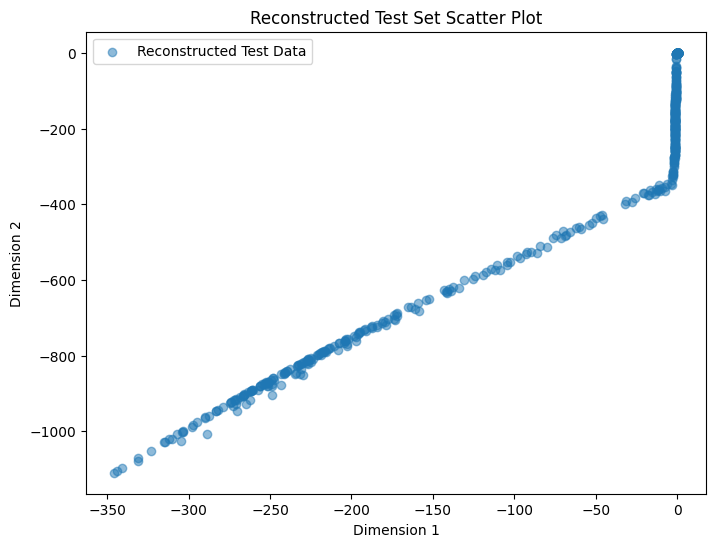

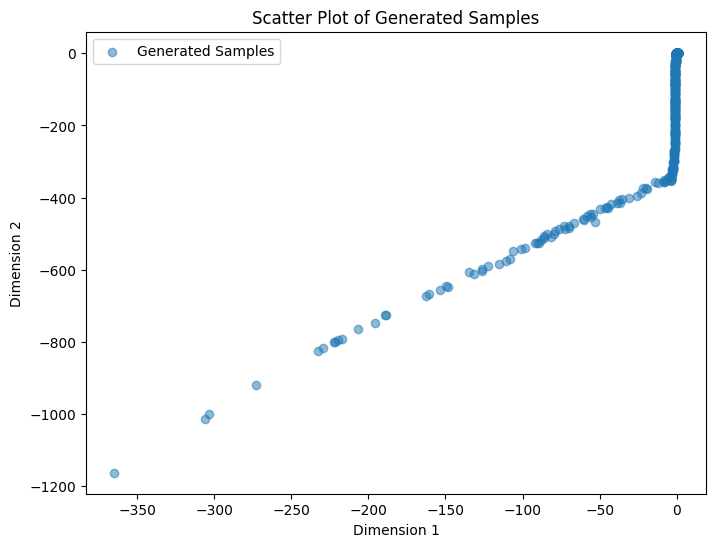

199.79338390346385 124.90688751564542
199.20925319802467 106.9705365584413
199.51506561983697 124.76337346637557
199.45700023917283 124.72788474559992
189.8264713376394 97.55893939456529
199.58567439641809 124.80652853898177
199.69745934756776 124.86367030030237
199.62885225511545 124.83194623205063
199.25753837241857 110.91003787989064
199.3369446302791 119.55911005155352
199.4861985349304 124.74573031862269
199.75183999987257 124.88817059692799
199.57429620936372 124.79957435026493
199.39384542362316 124.68378118782947
199.33445515879814 121.36641642975167
199.73885982766987 124.88232259792281
199.86883465438987 124.94088060119893
199.34236621342404 119.90722174116894
199.70957434273947 124.86912851082796
199.73594297946048 124.88100846277173
199.70298493210186 124.86615975793912
199.78726137316846 124.90412911306278
199.7138284957714 124.87104514471896
199.6852823331489 124.85818414493929
199.76452485785347 124.89388554841523
199.63011472137592 124.83263630019584
199.36111562502703 

"\n#plot_latent(vae, test_data)\n#test_tensor_reshaped = test_tensor.view(-1, 2).to(device)\n#print(test_tensor.shape)\n#plot_reconstructed(vae, test_tensor_reshaped)\n#plot_generated(vae)\n\ntest_losses = test(vae, test_tensor, epochs)\nprint('test',len(train_losses))\nprint('train',len(test_losses))\nplot_losses(train_losses,test_losses,epochs)\n"

In [15]:
#epoch 200
epochs = 200
train_losses = []
test_losses = []
vae= train(vae, train_loader,epochs)
plot_reconstructed_scatter(vae, test_data)
plot_generated_samples(vae)
estimate_critical_number(vae)
"""
#plot_latent(vae, test_data)
#test_tensor_reshaped = test_tensor.view(-1, 2).to(device)
#print(test_tensor.shape)
#plot_reconstructed(vae, test_tensor_reshaped)
#plot_generated(vae)

test_losses = test(vae, test_tensor, epochs)
print('test',len(train_losses))
print('train',len(test_losses))
plot_losses(train_losses,test_losses,epochs)
"""